In [380]:
import h5py as hdf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
plt.style.use({'figure.facecolor':'white'})

In [392]:
path='C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT-044.nxs'
with hdf.File(path, 'r') as f:
    groups = list(f.keys())
print (groups)

['entry']


In [393]:
with hdf.File(path, 'r') as f:
    groups = list(f['entry'].keys())
print (groups)

['instrument']


In [394]:
with hdf.File(path, 'r') as f:
    groups = list(f['entry']['instrument'].keys())
print (groups)


['xspress3']


In [395]:
with hdf.File(path, 'r') as f:
    groups = list(f['entry']['instrument']['xspress3'].keys())
print (groups)


['channel00', 'channel01']


In [396]:
with hdf.File(path, 'r') as f:
    groups = list(f['entry']['instrument']['xspress3']['channel00'].keys())
print (groups)


['histogram', 'scaler']


In [397]:
with hdf.File(path, 'r') as f:
    groups = list(f['entry']['instrument']['xspress3']['channel00']['histogram'])
print (groups)

[array([3277, 3706, 3842, ...,    0,    0,  902]), array([3619, 3727, 3816, ...,    1,    0,  879]), array([3474, 3540, 3694, ...,    0,    0,  819]), array([3509, 3582, 3886, ...,    0,    1,  828]), array([3505, 3592, 3733, ...,    0,    0,  863]), array([3511, 3596, 3759, ...,    0,    0,  806]), array([3529, 3624, 3730, ...,    0,    1,  810]), array([3472, 3624, 3894, ...,    2,    1,  829]), array([3609, 3682, 3841, ...,    0,    2,  848]), array([3581, 3645, 3800, ...,    0,    3,  815]), array([3458, 3740, 3883, ...,    0,    2,  818]), array([3530, 3818, 3903, ...,    0,    0,  828]), array([3645, 3823, 3866, ...,    1,    1,  897]), array([3597, 3677, 3995, ...,    0,    0,  843]), array([3641, 3749, 3877, ...,    1,    0,  851]), array([3582, 3817, 3946, ...,    1,    1,  829]), array([3573, 3783, 3845, ...,    1,    0,  872]), array([3621, 3658, 3891, ...,    1,    1,  828]), array([3646, 3714, 4034, ...,    1,    1,  836]), array([3763, 3739, 3960, ...,    0,    0,  866]),

In [398]:
df=pd.DataFrame(groups)

In [399]:
df

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,3277,3706,3842,3826,4148,4119,4196,4024,4109,4044,...,0,1,0,0,0,1,1,0,0,902
1,3619,3727,3816,3988,4092,4174,4294,4291,4159,3958,...,0,0,0,2,1,1,1,1,0,879
2,3474,3540,3694,3793,4001,4064,4149,4161,4024,3990,...,0,0,0,1,0,0,0,0,0,819
3,3509,3582,3886,3952,4002,4178,4248,4261,4107,4001,...,1,0,1,1,2,0,0,0,1,828
4,3505,3592,3733,3951,4128,4225,4129,4184,4004,3867,...,0,0,0,0,3,2,1,0,0,863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,206,245,144,69,32,18,8,2,3,0,...,1,1,0,0,0,1,1,2,1,502
496,81,65,48,14,12,3,3,0,1,1,...,0,1,1,0,1,1,0,0,0,433
497,190,222,155,101,38,32,12,7,4,4,...,0,2,0,0,0,1,1,0,0,483
498,86,80,46,21,8,4,3,2,0,3,...,0,0,0,0,1,1,1,0,0,522


<Figure size 1440x720 with 0 Axes>

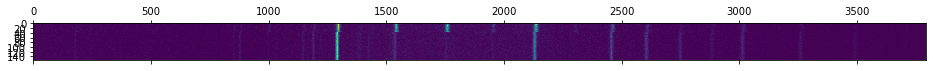

In [444]:
plt.figure(figsize=(20,10))
plt.matshow(df.iloc[:,150:])

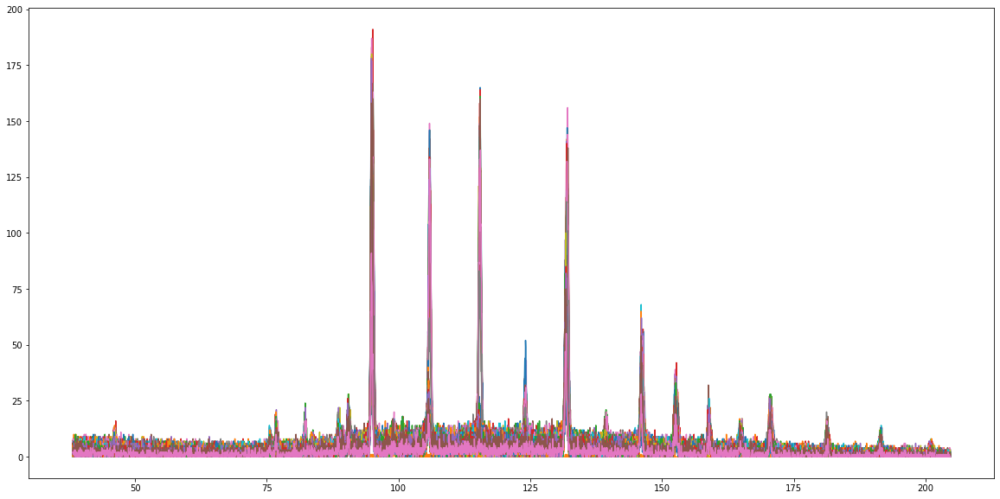

In [443]:
fig,ax=plt.subplots(figsize=(20,10))
for i in df.index:
    ax.plot(df.iloc[i,150:4094])

In [402]:
import nexusformat.nexus as nx
f= nx.nxload(path)
print (f.tree)
for key in f['entry']['instrument']['xspress3']['channel00']['scaler'].keys():
    print(key,f['entry']['instrument']['xspress3']['channel00']['scaler'][key][1])

root:NXroot
  entry:NXgroup
    instrument:NXgroup
      xspress3:NXgroup
        channel00:NXgroup
          histogram = int32(500x4096)
          scaler:NXgroup
            allevent = float32(500)
            allgood = float32(500)
            inwindow0 = float32(500)
            inwindow1 = float32(500)
            pileup = float32(500)
            resetcounts = float32(500)
            resetticks = float32(500)
            time = float32(500)
            totalticks = float32(500)
        channel01:NXgroup
          histogram = int32(500x4096)
          scaler:NXgroup
            allevent = float32(500)
            allgood = float32(500)
            inwindow0 = float32(500)
            inwindow1 = float32(500)
            pileup = float32(500)
            resetcounts = float32(500)
            resetticks = float32(500)
            time = float32(500)
            totalticks = float32(500)
allevent 281776.0
allgood 169878.0
inwindow0 3619.0
inwindow1 3619.0
pileup 156.0
resetcounts 18

In [403]:
nbframes=np.array(f['entry']['instrument']['xspress3']['channel00']['histogram'][:]).shape[0]
eresolution=np.array(f['entry']['instrument']['xspress3']['channel00']['histogram'][:]).shape[1]
energies=np.linspace(25,204.775,eresolution)

display(nbframes,eresolution)

500

4096

In [404]:
df0=pd.DataFrame(f['entry']['instrument']['xspress3']['channel01']['histogram'][:],columns=energies)
display(df0)
df0c=df0.iloc[:,150:4094]

,25.000000,25.043901,25.087802,25.131703,25.175604,25.219505,25.263407,25.307308,25.351209,25.395110,...,204.379890,204.423791,204.467692,204.511593,204.555495,204.599396,204.643297,204.687198,204.731099,204.775000
0,522,325,147,46,12,10,5,2,3,1,...,0,0,0,0,0,0,1,0,0,143
1,490,316,127,28,21,4,4,0,2,1,...,0,1,0,0,0,0,0,0,0,167
2,535,309,135,41,18,10,3,2,3,1,...,0,1,1,0,0,0,0,0,0,189
3,540,340,142,44,13,8,5,3,5,0,...,0,0,0,1,1,0,0,0,1,152
4,506,338,142,44,10,6,5,4,0,1,...,1,1,1,0,0,0,0,0,0,144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,4,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,132
496,2,4,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,129
497,2,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,125
498,6,4,0,0,0,0,0,0,0,0,...,0,1,0,0,0,1,1,1,0,129


In [405]:
import plotly.graph_objects as go
fig = go.Figure(data=[go.Surface(z=df0c.values, y=df0c.index, x=df0c.columns)])
fig.update_layout( autosize=True,
                  width=500, height=500,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

31.585165     5
31.629066     2
31.672967     1
31.716868     0
31.760769     2
             ..
204.511593    0
204.555495    1
204.599396    0
204.643297    0
204.687198    0
Name: 10, Length: 3944, dtype: int32

array([1349, 1449, 1696, ..., 2114, 2291, 2622], dtype=int64)

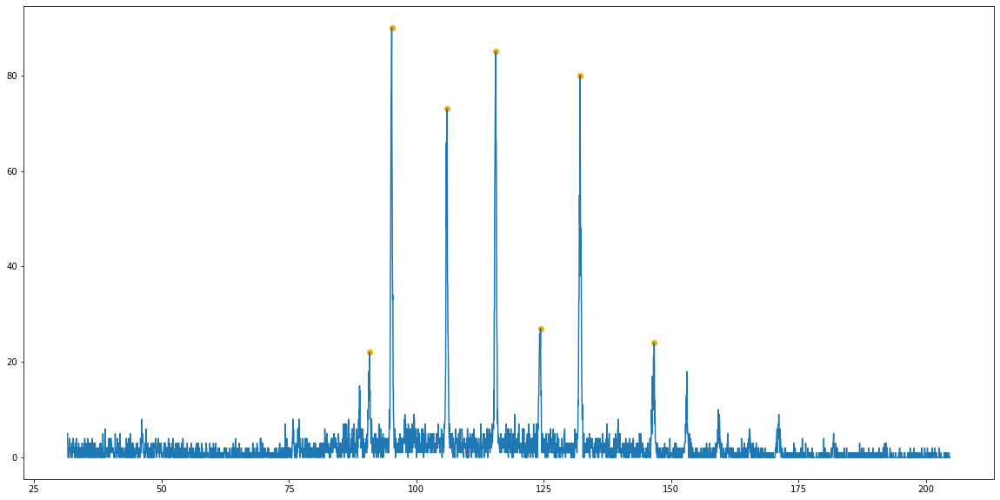

In [406]:
from scipy.signal import find_peaks as fp
fig,ax=plt.subplots(figsize=(20,10))
x=df0c.iloc[10,:]
ax.plot(x)
display(x)
peaks, properties = fp(x, prominence=(20, None),distance=5,width=2)
for peak in peaks:
    ax.scatter(x.index[peak],x.iloc[peak],color='orange')
display(peaks)

In [407]:
#from numpy import exp, loadtxt, pi, sqrt
#
#from lmfit import Model
#
#
#xf = x.index
#yf = x.values
#
#
#def gaussian(x, amp, cen, wid):
#    """1-d gaussian: gaussian(x, amp, cen, wid)"""
#    return (amp / (sqrt(2*pi) * wid)) * exp(-(x-cen)**2 / (2*wid**2))
#
#for peak in peaks:
#    gmodel = Model(gaussian)
#    result = gmodel.fit(yf, x=xf, amp=x.iloc[peak], cen=x.index[peak], wid=2)
#
#    print(result.fit_report())
#
#    plt.plot(xf, yf, '-',lw=0.5)
#    plt.plot(xf, result.init_fit, '--', label='initial fit')
#    plt.plot(xf, result.best_fit, '-', label='best fit')
#    plt.legend()
#    plt.show()

,peak_energies[keV]
0,"[90.76384615384616, 95.24175824175825, 106.041..."
1,"[90.89554945054945, 95.19785714285715, 106.041..."
2,"[88.9639010989011, 90.71994505494506, 95.15395..."
3,"[90.76384615384616, 95.06615384615385, 105.909..."
4,"[90.89554945054945, 95.15395604395604, 105.953..."
...,...
495,"[90.71994505494506, 95.11005494505496, 106.041..."
496,"[90.85164835164835, 95.19785714285715, 106.041..."
497,"[90.85164835164835, 95.11005494505496, 106.129..."
498,"[90.80774725274726, 95.11005494505496, 106.085..."


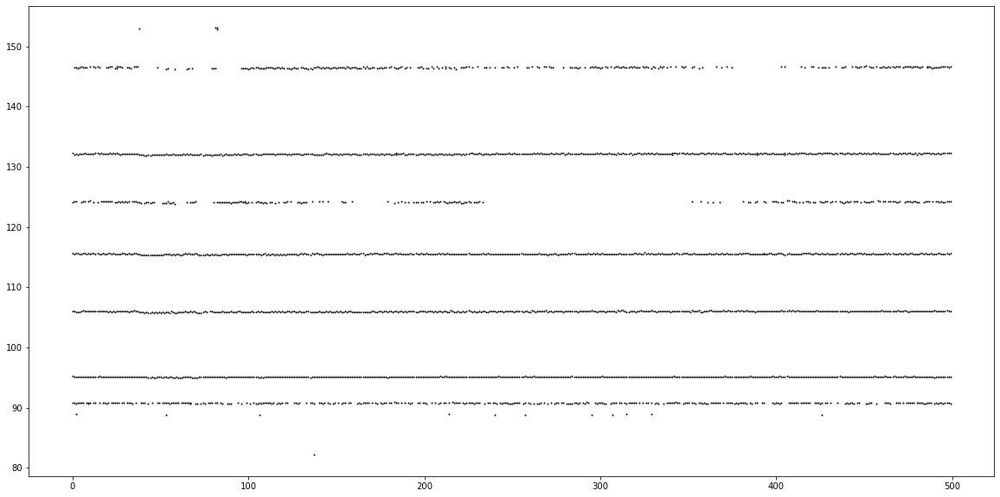

In [408]:
df0a=pd.DataFrame(index=df0c.index,columns=['peak_energies[keV]'])
runner=[]
for i in df0a.index:
    x=df0c.loc[i,:]
    #plt.plot(x)
    #plt.show()
    #display(x)
    peaks, properties = fp(x, prominence=(20, None),distance=5,width=2)
    runner.append(list(x.index[peaks]))
    df0a.loc[i,'peak_energies[keV]'] = runner[0]
    runner=[]
fig,ax=plt.subplots(figsize=(20,10))
display(df0a)
for i in df0a.index:
    for e in df0a.loc[i,'peak_energies[keV]']:
        ax.scatter(i,e,color='k',s=1)
plt.show()


In [409]:
def extract_between(lst,start,end):
    #print(lst)
    for i in lst:

        if i < end and i >= start :

            return i
    return np.nan

display(df0a)

,peak_energies[keV]
0,"[90.76384615384616, 95.24175824175825, 106.041..."
1,"[90.89554945054945, 95.19785714285715, 106.041..."
2,"[88.9639010989011, 90.71994505494506, 95.15395..."
3,"[90.76384615384616, 95.06615384615385, 105.909..."
4,"[90.89554945054945, 95.15395604395604, 105.953..."
...,...
495,"[90.71994505494506, 95.11005494505496, 106.041..."
496,"[90.85164835164835, 95.19785714285715, 106.041..."
497,"[90.85164835164835, 95.11005494505496, 106.129..."
498,"[90.80774725274726, 95.11005494505496, 106.085..."


In [410]:
runner=[]
for i in df0a.index:
    #print()
    runner.append(extract_between(df0a.loc[i,'peak_energies[keV]'],98,103))
df0a['_140-145keV']=runner
display(df0a)

,peak_energies[keV],_140-145keV
0,"[90.76384615384616, 95.24175824175825, 106.041...",NaN
1,"[90.89554945054945, 95.19785714285715, 106.041...",NaN
2,"[88.9639010989011, 90.71994505494506, 95.15395...",NaN
3,"[90.76384615384616, 95.06615384615385, 105.909...",NaN
4,"[90.89554945054945, 95.15395604395604, 105.953...",NaN
...,...,...
495,"[90.71994505494506, 95.11005494505496, 106.041...",NaN
496,"[90.85164835164835, 95.19785714285715, 106.041...",NaN
497,"[90.85164835164835, 95.11005494505496, 106.129...",NaN
498,"[90.80774725274726, 95.11005494505496, 106.085...",NaN


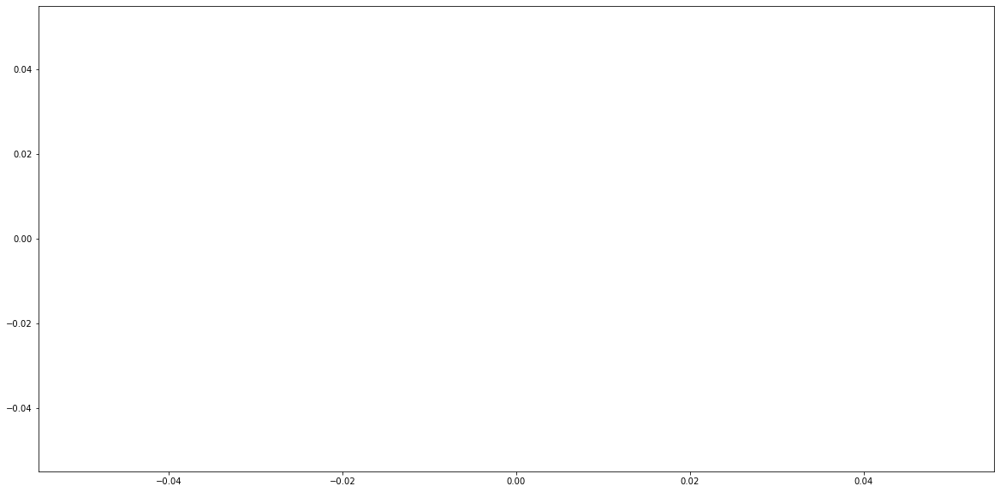

In [411]:
fig,ax=plt.subplots(figsize=(20,10))
ax.plot(df0a['_140-145keV'])

In [412]:
from scipy.signal import savgol_filter as savgol
res=savgol(df0a['_140-145keV'].values,15,3)
fig,ax=plt.subplots(figsize=(20,10))
ax.plot(df0a['_140-145keV'].ffill())
ax.plot(df0a['_140-145keV'].ffill().rolling(19,center=True).mean())

LinAlgError: SVD did not converge in Linear Least Squares

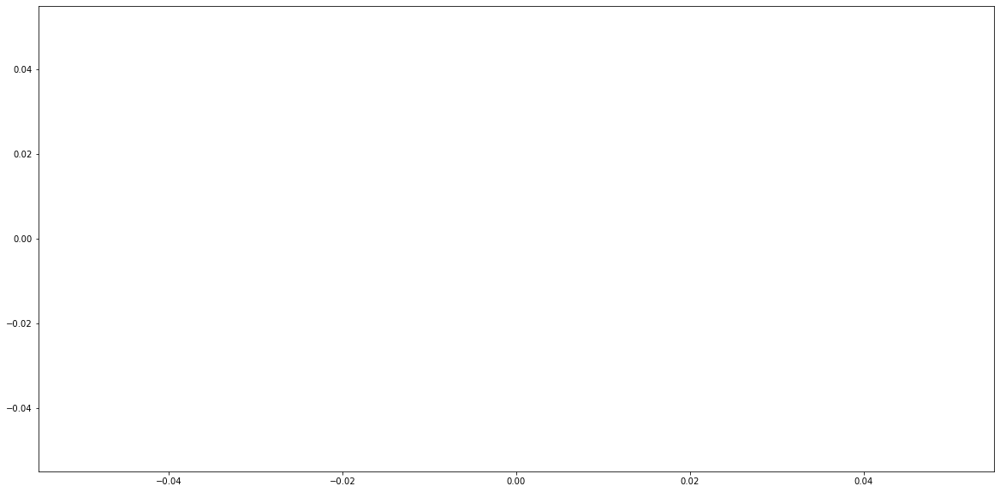

In [413]:
from statsmodels.nonparametric.kernel_regression import KernelReg
import numpy as np
import matplotlib.pyplot as plt

x = df0a['_140-145keV'].index
y = df0a['_140-145keV'].ffill()

kr = KernelReg(y,x,'c')

y_pred, y_std = kr.fit(x)

fig,ax=plt.subplots(figsize=(20,10))
ax.plot(x,y)
ax.plot(x,y_pred)

In [414]:
def gather_files_regex(dir: str, regex) -> list:
    '''
    Gathers all files below a directory that match the provided regular expression
    Traverses into sub-directories

    dir -- the directory

    regex -- A regular expression to match filenames
    '''
    #
    import re
    import os
    subdir = dir
    p = re.compile(regex)
    data = []
    for dir, _, files in os.walk(subdir):
        for name in files:
            if p.match(name):
                b = (str(os.path.join(dir, name)))
                data.append(b)

    return data
files=gather_files_regex('C:\\Users\\maede\\DESY\\data\\laht',r'\S*nxs\Z')






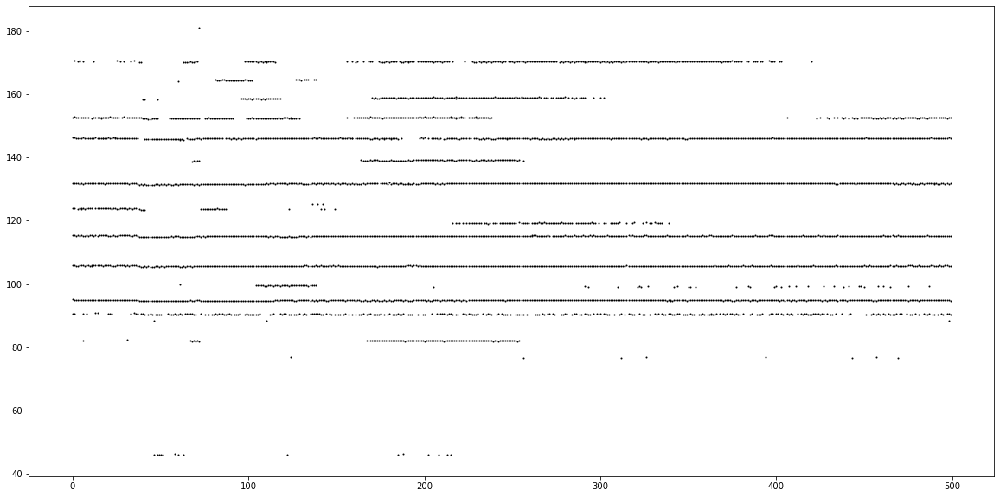

In [415]:
def load_nxs(path):
    import nexusformat.nexus as nx
    f= nx.nxload(path)
    nbframes=np.array(f['entry']['instrument']['xspress3']['channel00']['histogram'][:]).shape[0]
    eresolution=np.array(f['entry']['instrument']['xspress3']['channel00']['histogram'][:]).shape[1]
    energies=np.linspace(25,204.775,eresolution)
    
    df0=pd.DataFrame(f['entry']['instrument']['xspress3']['channel00']['histogram'][:],columns=energies)
    df1=pd.DataFrame(f['entry']['instrument']['xspress3']['channel01']['histogram'][:],columns=energies)
    
    
    df0c=df0.iloc[:,150:4094]
    df1c=df1.iloc[:,150:4094]

    return (df0c, df1c)

def get_energy_peaks (df):
    from scipy.signal import find_peaks as fp
    dfr=pd.DataFrame(index=df.index)
    collector=[]
    for i in df.index:
        x=df.loc[i,:]
        peaks, properties = fp(x, prominence=(20, None),distance=5,width=2)
        collector.append(list(x.index[peaks]))

    dfr['peak_energies[keV]']=collector
    return dfr

def extract_between(lst,start,end):
    #print(lst)
    for i in lst:

        if i < end and i >= start :

            return i
    return np.nan

def separate_energy_peak(df,start,end):
    runner=[]
    for i in df.index:
        runner.append(extract_between(df.loc[i,'peak_energies[keV]'],start,end))
    colname='_'+str(start)+'-'+str(end)+'[keV]'
    df[colname]=runner
    return(df)

def disp_peak_move(df):
    fig,ax=plt.subplots(figsize=(20,10))
    #display(df)
    for i in df.index:
        for e in df.loc[i,'peak_energies[keV]']:
            ax.scatter(i,e,color='k',s=1)
    plt.show()



df0,df1=load_nxs(files[2])
dfr0=get_energy_peaks(df0)
dfr0=separate_energy_peak(dfr0,110,120)
disp_peak_move(dfr0)

def extract_ss_mean(df):
    return (np.mean(df.iloc[:,1][15:30]))






In [416]:

display(dfr0)

,peak_energies[keV],_110-120[keV]
0,"[90.67604395604396, 95.11005494505496, 105.909...",115.392363
1,"[90.63214285714287, 95.06615384615385, 105.865...",115.480165
2,"[95.02225274725275, 105.73412087912088, 115.26...",115.260659
3,"[95.02225274725275, 105.73412087912088, 115.39...",115.392363
4,"[95.02225274725275, 105.82192307692308, 115.26...",115.260659
...,...,...
495,"[90.41263736263737, 94.93445054945056, 105.734...",115.260659
496,"[94.84664835164835, 105.77802197802198, 115.30...",115.304560
497,"[90.50043956043956, 94.93445054945056, 105.821...",115.304560
498,"[88.48098901098902, 90.50043956043956, 94.8466...",115.128956


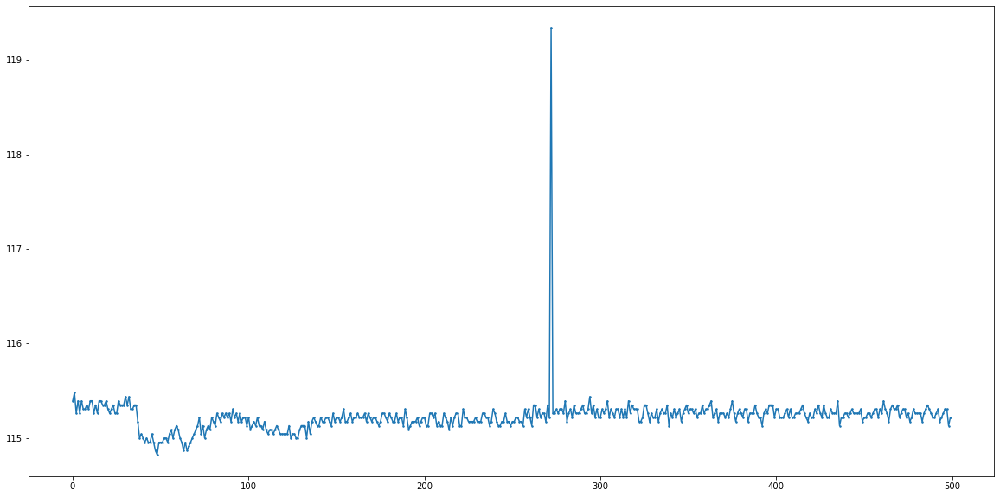

In [417]:
fig,ax=plt.subplots(figsize=(20,10))
ax.plot(dfr0.iloc[:,1],'o-',markersize=1.5)

In [418]:
import re
def getx(x):
    try:
        return float(re.findall(r"\((\S\d+)[,|;]",x)[0])
    except:
        return np.nan
def gety(x):
    try:
        return float(re.findall(r"[,|;](\S+)[,|;]",x)[0])
    except:
        return np.nan
def getz(x):
    try:
        return float(re.findall(r"\S*[,|;](\S*)\)",x)[0])
    except:
        return np.nan

pos=pd.read_csv('positions.txt',sep='\t',header=None)
pos.columns=['sample','pos']
pos.pos=pos.pos.astype(str)
display(pos)
pos['x']=pos.pos.apply(getx)
pos['y']=pos.pos.apply(gety)
pos['z']=pos.pos.apply(getz)
pos

,sample,pos
0,HA_001,(-15;0;1)
1,HA_002,(-15;0;1)
2,HA_003,(-100;0;1)
3,HA_004,(-150;0;1)
4,HA_005,(-20;0;4)
...,...,...
145,LA_144,"(-50,0,8)"
146,LA_145,"(-25,0,2.5)"
147,HA_146,"(-20,0,1)"
148,HA_147,"(-20,0,1)"


,sample,pos,x,y,z
0,HA_001,(-15;0;1),-15.0,0.0,1.0
1,HA_002,(-15;0;1),-15.0,0.0,1.0
2,HA_003,(-100;0;1),-100.0,0.0,1.0
3,HA_004,(-150;0;1),-150.0,0.0,1.0
4,HA_005,(-20;0;4),-20.0,0.0,4.0
...,...,...,...,...,...
145,LA_144,"(-50,0,8)",-50.0,0.0,8.0
146,LA_145,"(-25,0,2.5)",-25.0,0.0,2.5
147,HA_146,"(-20,0,1)",-20.0,0.0,1.0
148,HA_147,"(-20,0,1)",-20.0,0.0,1.0


In [419]:
import re
def getx(x):
    return re.findall(r"\((\S\d+)[,|;]",x)[0]
def gety(x):
    return re.findall(r"[,|;](\S+)[,|;]",x)[0]
def getz(x):
    return re.findall(r"\S*[,|;](\S*)\)",x)[0]
x=float(re.findall(r"\((\S\d+)[,|;]",pos.loc[1,'pos'])[0])
y=float(re.findall(r"[,|;](\S+)[,|;]",pos.loc[1,'pos'])[0])
z=float(re.findall(r"\S*[,|;](\S*)\)",pos.loc[1,'pos'])[0])
x,y,z
pos.dropna(axis=0,inplace=True)
pos.set_index('sample',inplace=True)

In [420]:
LAHT_nofiller=(pd.read_csv('LAHT_nofiller.txt',header=None))


LAHT_nofiller=list(LAHT_nofiller.iloc[:,0].values)
LAHT_nofiller

['LAHT_040',
 'LAHT_041',
 'LAHT_042',
 'LAHT_043',
 'LAHT_044',
 'LAHT_045',
 'LAHT_046',
 'LAHT_047',
 'LAHT_048',
 'LAHT_049',
 'LAHT_050',
 'LAHT_051',
 'LAHT_052',
 'LAHT_053',
 'LAHT_087',
 'LAHT_088',
 'LAHT_089',
 'LAHT_090',
 'LAHT_091',
 'LAHT_092',
 'LAHT_093',
 'LAHT_094',
 'LAHT_095',
 'LAHT_096',
 'LAHT_097',
 'LAHT_098',
 'LAHT_099',
 'LAHT_100',
 'LAHT_101']

(-19.05, 158.05, -21.95, -1.0499999999999998)

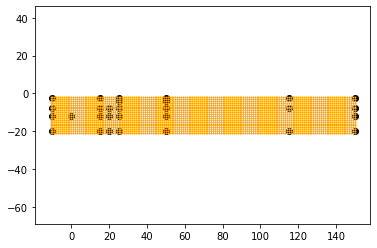

In [421]:
lahtnf=pos.loc[LAHT_nofiller,:]
plt.scatter(-lahtnf.x,-lahtnf.z,color='k')
def minmax(x):
    return np.min(x)-1,np.max(x)+1

X,Y= np.meshgrid(np.arange(*minmax(-lahtnf.x)),np.arange(*minmax(-lahtnf.z)))
plt.scatter(np.ravel(X),np.ravel(Y),color='orange',s=1)
plt.axis('equal')

In [422]:
import scipy
scipy.interpolate.interp2d(x, y, z)
for i in pos.index:
    print(i)

error: (mx>kx) failed for hidden mx: regrid_smth:mx=1

In [423]:
f=files
for i,val in enumerate(files):
    f[i]=f[i].replace('T-','T_')
display(f)

['C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_040.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_041.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_042.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_043.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_044.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_045.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_046.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_047.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_048.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_049.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_050.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_051.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_052.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_053.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_087.nxs',
 'C:\\Users\\maede\\DESY\\data\\laht\\d5kW_oZW_LAHT_088.nxs',
 'C:\\Us

In [424]:
filedf=pd.DataFrame()
filedf['files']=f
def extractname(x):
    return re.findall(r'\S*_(LAHT\S*)\.nxs',x)[0]

filedf['names']=filedf.files.apply(extractname)
filedf

,files,names
0,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_040
1,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_041
2,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_042
3,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_043
4,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_044
5,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_045
6,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_046
7,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_047
8,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_048
9,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT_04...,LAHT_049


In [425]:
filedf=filedf.join(pos.loc[filedf.names,:],on='names')

In [426]:
filedf.files=filedf.files.apply(lambda x : x.replace('T_','T-'))

filedf['rspectra']=filedf.files.apply(load_nxs)
filedf

,files,names,pos,x,y,z,rspectra
0,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_040,(-150;0;12),-150.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6..."
1,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_041,(-50;0;12),-50.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6..."
2,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_042,(-25;0;12),-25.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6..."
3,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_043,(-15;0;12),-15.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6..."
4,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_044,(-0;0;12),-0.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6..."
5,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_045,(10;0;12),10.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6..."
6,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_046,(10;0;2.5),10.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6..."
7,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_047,(-15;0;2.5),-15.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6..."
8,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_048,(-25;0;2.5),-25.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6..."
9,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_049,(-150;0;2.5),-150.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6..."


In [427]:
filedf['ch0_energypeaks']=filedf.rspectra.apply(lambda x: get_energy_peaks(x[0]))
filedf

,files,names,pos,x,y,z,rspectra,ch0_energypeaks
0,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_040,(-150;0;12),-150.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
1,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_041,(-50;0;12),-50.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
2,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_042,(-25;0;12),-25.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
3,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_043,(-15;0;12),-15.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
4,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_044,(-0;0;12),-0.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
5,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_045,(10;0;12),10.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
6,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_046,(10;0;2.5),10.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
7,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_047,(-15;0;2.5),-15.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
8,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_048,(-25;0;2.5),-25.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...
9,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_049,(-150;0;2.5),-150.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...


In [428]:
filedf['ch1_energypeaks']=filedf.rspectra.apply(lambda x: get_energy_peaks(x[1]))
filedf


,files,names,pos,x,y,z,rspectra,ch0_energypeaks,ch1_energypeaks
0,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_040,(-150;0;12),-150.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
1,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_041,(-50;0;12),-50.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
2,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_042,(-25;0;12),-25.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
3,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_043,(-15;0;12),-15.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
4,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_044,(-0;0;12),-0.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
5,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_045,(10;0;12),10.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
6,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_046,(10;0;2.5),10.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
7,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_047,(-15;0;2.5),-15.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
8,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_048,(-25;0;2.5),-25.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...
9,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_049,(-150;0;2.5),-150.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...


In [429]:
filedf['ch0_energypeaks']=filedf['ch0_energypeaks'].apply(lambda x : separate_energy_peak(x,103,110))
filedf['ch1_energypeaks']=filedf['ch1_energypeaks'].apply(lambda x : separate_energy_peak(x,103,110))

In [430]:
filedf.ch1_energypeaks[0]

,peak_energies[keV],_103-110[keV]
0,[],NaN
1,[],NaN
2,[],NaN
3,[],NaN
4,"[95.15395604395604, 115.52406593406594, 132.07...",NaN
...,...,...
495,"[90.80774725274726, 95.11005494505496, 106.041...",106.041429
496,"[90.85164835164835, 95.24175824175825, 105.997...",105.997527
497,"[90.85164835164835, 95.19785714285715, 105.953...",105.953626
498,"[90.80774725274726, 95.24175824175825, 105.865...",105.865824


In [431]:
extract_ss_mean
filedf['ch0_103-110[keV]']=filedf['ch0_energypeaks'].apply(extract_ss_mean)
filedf['ch1_103-110[keV]']=filedf['ch1_energypeaks'].apply(extract_ss_mean)
filedf

,files,names,pos,x,y,z,rspectra,ch0_energypeaks,ch1_energypeaks,ch0_103-110[keV],ch1_103-110[keV]
0,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_040,(-150;0;12),-150.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.734121,105.751681
1,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_041,(-50;0;12),-50.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.751681,105.780949
2,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_042,(-25;0;12),-25.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.786802,105.839484
3,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_043,(-15;0;12),-15.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.821923,105.921432
4,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_044,(-0;0;12),-0.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.880458,106.029722
5,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_045,(10;0;12),10.0,0.0,12.0,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.868751,106.023868
6,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_046,(10;0;2.5),10.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.938993,106.023868
7,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_047,(-15;0;2.5),-15.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,104.882440,103.111030
8,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_048,(-25;0;2.5),-25.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,NaN,103.137684
9,C:\Users\maede\DESY\data\laht\d5kW_oZW_LAHT-04...,LAHT_049,(-150;0;2.5),-150.0,0.0,2.5,"([31.585164835164836, 31.629065934065935, 31.6...",peak_energ...,peak_energ...,105.221941,105.611198


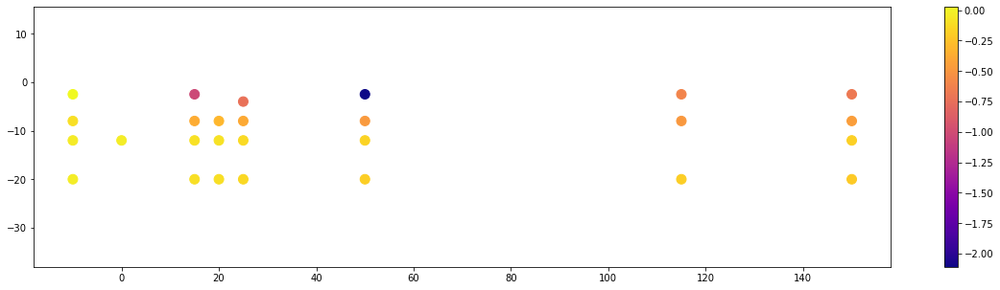

In [432]:
fig,ax=plt.subplots(figsize=(20,5))
im=ax.scatter(-filedf.x , -filedf.z, c=filedf['ch0_103-110[keV]']-105.90972527472528, alpha=1,cmap=plt.cm.plasma, s=100, zorder=1)
plt.colorbar(im)
plt.axis('equal')
plt.show()

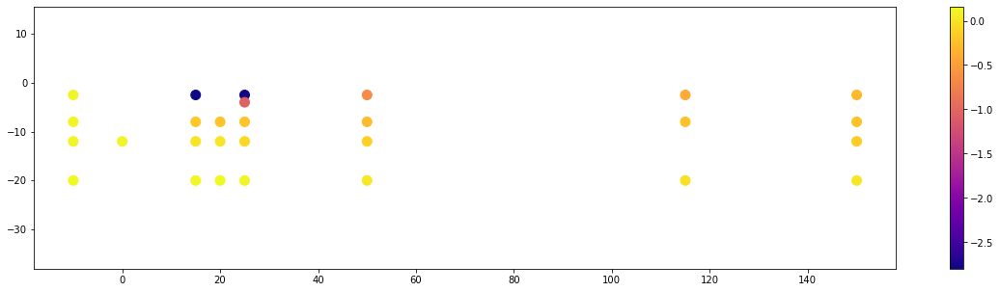

In [433]:
#-105.90972527472528
fig,ax=plt.subplots(figsize=(20,5))
im=ax.scatter(-filedf.x , -filedf.z, c=filedf['ch1_103-110[keV]']-105.90972527472528, alpha=1,cmap=plt.cm.plasma, s=100, zorder=1)
plt.colorbar(im)
plt.axis('equal')
plt.show()

In [434]:
import scipy
f0=scipy.interpolate.interp2d(-filedf.x, -filedf.z, filedf['ch0_103-110[keV]'], kind='cubic')
f1=scipy.interpolate.interp2d(-filedf.x, -filedf.z, filedf['ch1_103-110[keV]'], kind='cubic')
X,Y= np.meshgrid(np.arange(*minmax(-lahtnf.x)),np.arange(*minmax(-lahtnf.z)))
xnew=np.ravel(X)
ynew=np.ravel(Y)
z1new=[f1(xnew[i],ynew[i]) for i, val in enumerate(xnew)]
display(z1new)

C:\Users\maede\Anaconda3\envs\DESY\lib\site-packages\scipy\interpolate\_fitpack_impl.py:977: RuntimeWarning:

No more knots can be added because the number of B-spline
coefficients already exceeds the number of data points m.
Probable causes: either s or m too small. (fp>s)
	kx,ky=3,3 nx,ny=10,9 m=29 fp=nan s=0.000000



[array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([nan]),
 array([na

NotImplementedError: Axes3D currently only supports the aspect argument 'auto'. You passed in 'equal'.

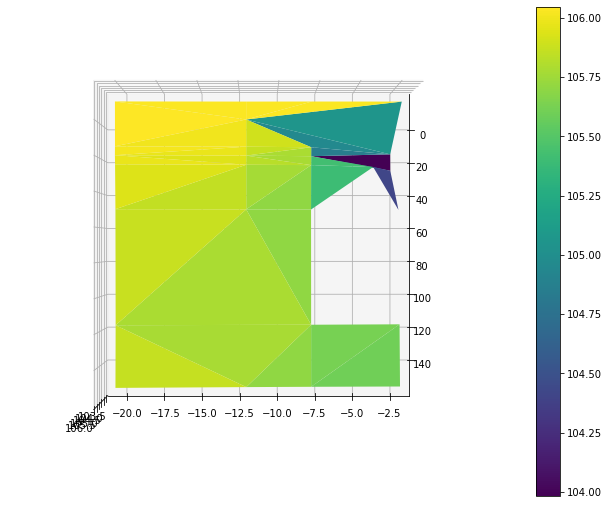

In [435]:
fig = plt.figure(figsize =(14, 9))
ax = plt.axes(projection ='3d')
im=ax.plot_trisurf(-filedf.x, -filedf.z, filedf['ch1_103-110[keV]'], linewidth = 0.2,antialiased = True,cmap='viridis');
ax.view_init(azim=0, elev=90)
plt.colorbar(im)
plt.axis('equal')
plt.show()

(29,)

(29,)

(29,)

C:\Users\maede\Anaconda3\envs\DESY\lib\site-packages\scipy\interpolate\_fitpack_impl.py:977: RuntimeWarning:

No more knots can be added because the number of B-spline
coefficients already exceeds the number of data points m.
Probable causes: either s or m too small. (fp>s)
	kx,ky=3,3 nx,ny=10,9 m=29 fp=nan s=0.000000



array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

TypeError: Dimensions of C (20, 162) are incompatible with X (162) and/or Y (20); see help(pcolormesh)

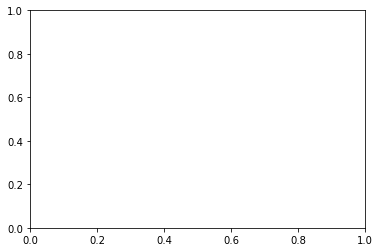

In [436]:
from scipy import interpolate
x=-filedf.x
y=-filedf.z
z=filedf['ch1_103-110[keV]']
display(x.shape,y.shape,z.shape)
tck = interpolate.bisplrep(x, y, z, s=0)
znew = interpolate.bisplev(X[:,0], Y[0,:], tck)
plt.figure()
lims = dict(cmap='RdBu_r', vmin=-0.25, vmax=0.25)

display(znew)
plt.pcolormesh(Y, X, znew, shading='flat', )
plt.colorbar()

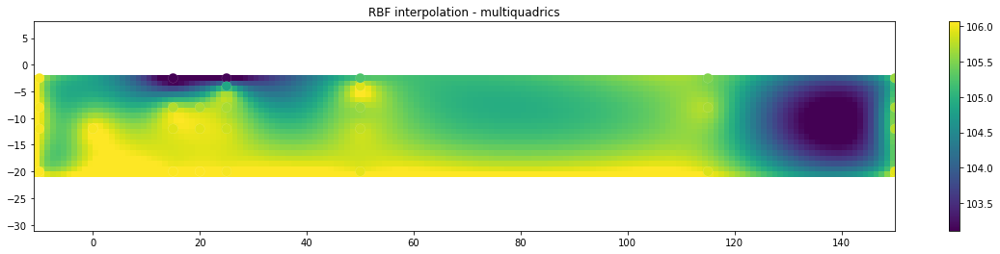

(-0.5, 160.5, -0.5, 18.5)

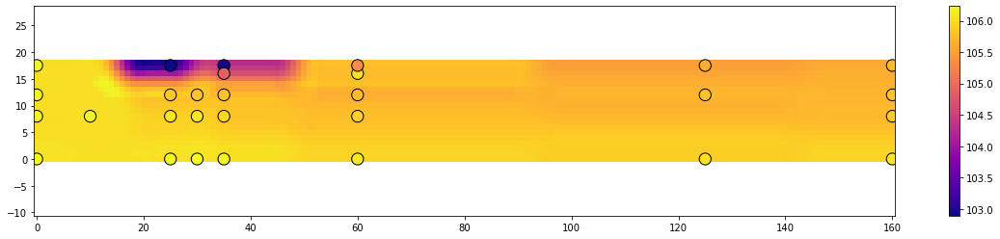

In [437]:
import numpy as np
from scipy.interpolate import Rbf
import matplotlib.pyplot as plt
from matplotlib import cm
x=-filedf.x
y=-filedf.z
z=filedf['ch1_103-110[keV]']
z=z.fillna(105.90972527472528)
#display(x,y,z)
xedges = np.arange(*minmax(x))
yedges = np.arange(*minmax(y))

xcenters = xedges[:-1] + np.diff(xedges[:2])[0] / 2.
ycenters = yedges[:-1] + np.diff(yedges[:2])[0] / 2.

XI, YI = np.meshgrid(xcenters, ycenters)

rbf = Rbf(x, y, z, epsilon=2)
ZI = rbf(XI, YI)


plt.subplots(figsize=(20,4))
X_edges, Y_edges = np.meshgrid(xedges, yedges)
lims = dict(cmap='viridis', vmin=103.5, vmax=106.0)
plt.pcolormesh(X_edges, Y_edges, ZI, shading='flat', **lims)
plt.scatter(x, y, 100, z, edgecolor='w', lw=0.1, )
plt.title('RBF interpolation - multiquadrics')
plt.axis('equal')
#plt.xlim(-2, 2)
#plt.ylim(-2, 2)
plt.colorbar()
plt.show()


def sgolay2d(z, window_size, order, derivative=None):
    """
    performs smoothing based on the given parameters, does not accept NaNs as a input
    """
    import numpy as np
    import scipy
    #
    # number of terms in the polynomial expression
    n_terms = (order + 1) * (order + 2) / 2.0

    if window_size % 2 == 0:
        window_size = window_size + 1
        # raise ValueError('window_size must be odd')

    if window_size ** 2 < n_terms:
        raise ValueError('order is too high for the window size')

    half_size = window_size // 2

    # exponents of the polynomial.
    # p(x,y) = a0 + a1*x + a2*y + a3*x^2 + a4*y^2 + a5*x*y + ...
    # this line gives a list of two item tuple. Each tuple contains
    # the exponents of the k-th term. First element of tuple is for x
    # second element for y.
    # Ex. exps = [(0,0), (1,0), (0,1), (2,0), (1,1), (0,2), ...]
    exps = [(k - n, n) for k in range(order + 1) for n in range(k + 1)]

    # coordinates of points
    ind = np.arange(-half_size, half_size + 1, dtype=np.float64)
    dx = np.repeat(ind, window_size)
    dy = np.tile(ind, [window_size, 1]).reshape(window_size ** 2, )

    # build matrix of system of equation
    A = np.empty((window_size ** 2, len(exps)))
    for i, exp in enumerate(exps):
        A[:, i] = (dx ** exp[0]) * (dy ** exp[1])

    # pad input array with appropriate values at the four borders
    new_shape = z.shape[0] + 2 * half_size, z.shape[1] + 2 * half_size
    Z = np.zeros(new_shape)
    # top band
    band = z[0, :]
    Z[:half_size, half_size:-half_size] = band - np.abs(np.flipud(z[1:half_size + 1, :]) - band)
    # bottom band
    band = z[-1, :]
    Z[-half_size:, half_size:-half_size] = band + np.abs(np.flipud(z[-half_size - 1:-1, :]) - band)
    # left band
    band = np.tile(z[:, 0].reshape(-1, 1), [1, half_size])
    Z[half_size:-half_size, :half_size] = band - np.abs(np.fliplr(z[:, 1:half_size + 1]) - band)
    # right band
    band = np.tile(z[:, -1].reshape(-1, 1), [1, half_size])
    Z[half_size:-half_size, -half_size:] = band + np.abs(np.fliplr(z[:, -half_size - 1:-1]) - band)
    # central band
    Z[half_size:-half_size, half_size:-half_size] = z

    # top left corner
    band = z[0, 0]
    Z[:half_size, :half_size] = band - np.abs(np.flipud(np.fliplr(z[1:half_size + 1, 1:half_size + 1])) - band)
    # bottom right corner
    band = z[-1, -1]
    Z[-half_size:, -half_size:] = band + np.abs(np.flipud(np.fliplr(z[-half_size - 1:-1, -half_size - 1:-1])) - band)

    # top right corner
    band = Z[half_size, -half_size:]
    Z[:half_size, -half_size:] = band - np.abs(np.flipud(Z[half_size + 1:2 * half_size + 1, -half_size:]) - band)
    # bottom left corner
    band = Z[-half_size:, half_size].reshape(-1, 1)
    Z[-half_size:, :half_size] = band - np.abs(np.fliplr(Z[-half_size:, half_size + 1:2 * half_size + 1]) - band)

    # solve system and convolve
    if derivative == None:
        m = np.linalg.pinv(A)[0].reshape((window_size, -1))
        return scipy.signal.fftconvolve(Z, m, mode='valid')
    elif derivative == 'col':
        c = np.linalg.pinv(A)[1].reshape((window_size, -1))
        return scipy.signal.fftconvolve(Z, -c, mode='valid')
    elif derivative == 'row':
        r = np.linalg.pinv(A)[2].reshape((window_size, -1))
        return scipy.signal.fftconvolve(Z, -r, mode='valid')
    elif derivative == 'both':
        c = np.linalg.pinv(A)[1].reshape((window_size, -1))
        r = np.linalg.pinv(A)[2].reshape((window_size, -1))
        return scipy.signal.fftconvolve(Z, -r, mode='valid'), scipy.signal.fftconvolve(Z, -c, mode='valid')

fig,ax=plt.subplots(figsize=(20,4))
from scipy.interpolate import griddata
grid_z0 = griddata(list(zip(x,y)), z, (XI, YI), method='nearest')
a=ax.imshow(sgolay2d(grid_z0,9,3),  origin='lower',cmap='plasma')
#a=ax.imshow(grid_z0,  origin='lower',cmap='plasma')

ax.scatter(x+10, y+20, 150, z, edgecolor='k', lw=1, cmap='plasma')
plt.colorbar(a)
plt.axis('equal')

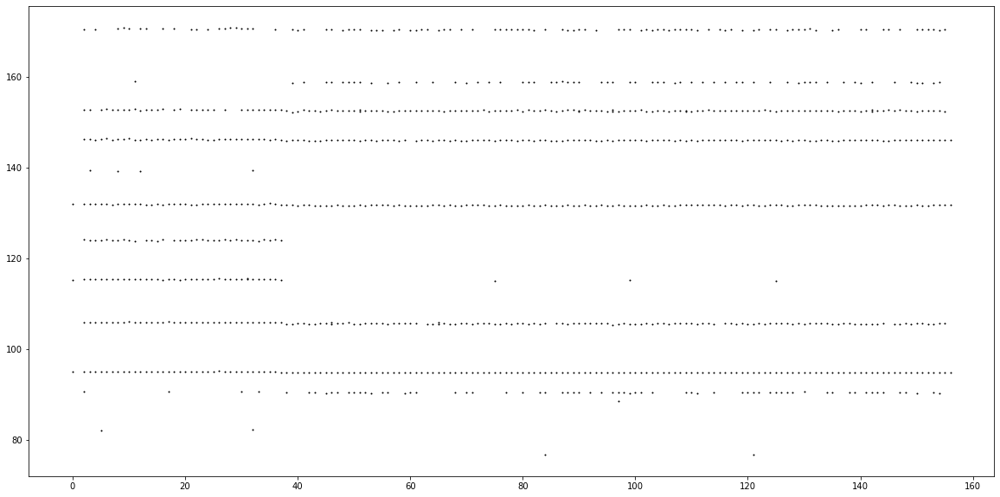

,peak_energies[keV],_103-110[keV]
0,"[95.02225274725275, 115.26065934065934, 131.98...",NaN
1,[],NaN
2,"[90.67604395604396, 95.06615384615385, 105.909...",105.909725
3,"[95.02225274725275, 105.95362637362638, 115.39...",105.953626
4,"[95.11005494505496, 105.95362637362638, 115.43...",105.953626
...,...,...
152,"[94.89054945054946, 105.60241758241759, 131.59...",105.602418
153,"[90.41263736263737, 94.89054945054946, 105.602...",105.602418
154,"[90.32483516483516, 94.84664835164835, 105.734...",105.734121
155,"[94.84664835164835, 105.69021978021978, 131.76...",105.690220


In [438]:
df=load_nxs('data/d0kW_oZW_LAHT_reference.nxs')[0]
peak_df=get_energy_peaks(df)
peak_df=separate_energy_peak(peak_df,103,110)
disp_peak_move(peak_df)
peak_df

In [439]:
extract_ss_mean(peak_df)

105.90972527472528

In [440]:
files=gather_files_regex('G:\\2021-12-07_Desy_Messdaten\\complete\\raw',r'\S*nxs\Z')
display(files)

['G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\IronPowder_2021-12-14_19-59-09.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\IronPowder_2021-12-14_19-59-09_1639509029.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\IronPowder_2021-12-14_19-59-09_1639509056.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\NickelPowder_2021-12-14_19-56-27.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\NickelPowder_2021-12-14_19-56-27_1639508302.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\SiliconPowder_2021-12-14_19-54-21.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Calibrants\\SiliconPowder_2021-12-14_19-54-21_1639508135.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\Fail-2\\alignment\\LAHT_102_15406.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\fail6\\experiments\\d5kW_oZW_HA_085.nxs',
 'G:\\2021-12-07_Desy_Messdaten\\complete\\raw\\fail6\\experiments\\d5kW_oZW_HA_085_15385

In [441]:
for file in files:
    print (file)

G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\IronPowder_2021-12-14_19-59-09.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\IronPowder_2021-12-14_19-59-09_1639509029.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\IronPowder_2021-12-14_19-59-09_1639509056.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\NickelPowder_2021-12-14_19-56-27.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\NickelPowder_2021-12-14_19-56-27_1639508302.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\SiliconPowder_2021-12-14_19-54-21.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Calibrants\SiliconPowder_2021-12-14_19-54-21_1639508135.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\Fail-2\alignment\LAHT_102_15406.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\fail6\experiments\d5kW_oZW_HA_085.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\fail6\experiments\d5kW_oZW_HA_085_15385.nxs
G:\2021-12-07_Desy_Messdaten\complete\raw\FirstWeld\alignment\FirstWeld_14999.nxs
G:\2